In [ ]:
%cd /content

/content


# *Hi, THE FOLLOWING STEPS ARE DONE TO EXPLORE DATA AND CREATE TRAIN AND TEST DATA*

In [1]:
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu,corpus_bleu
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


In [3]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('/content/vgg16_gru')

**Hi, don't forget to first upload the data on your own drive, and make sure there are no restrictions involved through drive.**

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
!unzip /content/drive/MyDrive/Filckr8k.zip

Streaming output truncated to the last 5000 lines.
  inflating: Filckr8k/Images/2844846111_8c1cbfc75d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2844846111_8c1cbfc75d.jpg  
  inflating: Filckr8k/Images/1082252566_8c79beef93.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1082252566_8c79beef93.jpg  
  inflating: Filckr8k/Images/1386251841_5f384a0fea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._1386251841_5f384a0fea.jpg  
  inflating: Filckr8k/Images/2196316998_3b2d63f01f.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2196316998_3b2d63f01f.jpg  
  inflating: Filckr8k/Images/3106791484_13e18c33d8.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3106791484_13e18c33d8.jpg  
  inflating: Filckr8k/Images/3603064161_a8f3b6455d.jpg  
  inflating: __MACOSX/Filckr8k/Images/._3603064161_a8f3b6455d.jpg  
  inflating: Filckr8k/Images/2293149170_38fb2257ea.jpg  
  inflating: __MACOSX/Filckr8k/Images/._2293149170_38fb2257ea.jpg  
  inflating: Filckr8k/Images/2451114871_8617ae2f16.jpg  
  inflating: __MA

In [6]:
image_data_location = "/content/Filckr8k/Images"
caption_data_location = "/content/Filckr8k/captions_images.txt"

In [7]:
df = pd.read_csv(caption_data_location)

In [8]:
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   image    40455 non-null  object
 1   caption  40455 non-null  object
dtypes: object(2)
memory usage: 632.2+ KB


In [10]:
train_data_df = df.iloc[:40000,:]
test_data_df = df.iloc[40000:,:]

In [11]:
train_data_df.tail()

,image,caption
39995,887108308_2da97f15ef.jpg,A child walks while holding an adult 's hand .
39996,887108308_2da97f15ef.jpg,A man holds a child 's hand as they walk .
39997,887108308_2da97f15ef.jpg,A woman walks hand-in-hand with a little boy w...
39998,887108308_2da97f15ef.jpg,A young boy has his hand in the back of his pa...
39999,887108308_2da97f15ef.jpg,The man is walking with a young child outside .


In [12]:
test_data_df.head()

,image,caption
40000,888425986_e4b6c12324.jpg,A boy is upside down in midair near a lake at ...
40001,888425986_e4b6c12324.jpg,A person does a flip by two sailboats and a la...
40002,888425986_e4b6c12324.jpg,A person flipping upside down
40003,888425986_e4b6c12324.jpg,a person in midair doing a back flip .
40004,888425986_e4b6c12324.jpg,A person is doing a flip in midair near a lake...


In [13]:
train_data_df.to_csv('train_captions.txt',index = False)
test_data_df.to_csv('test_captions.txt', index = False)

In [14]:
train_data_location = '/content/train_captions.txt'
test_data_location = '/content/test_captions.txt'

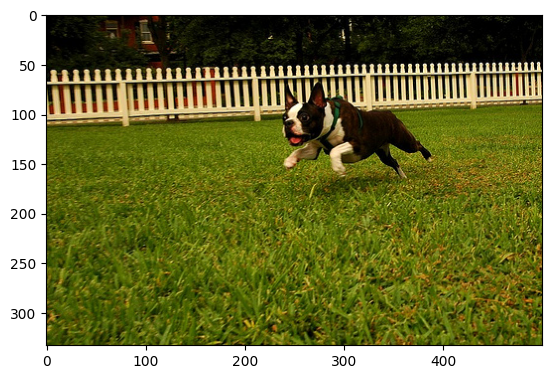

Caption - A dog runs on the green grass near a wooden fence .
Caption - A dog shakes its head near the shore , a red ball next to it .
Caption - A white dog shakes on the edge of a beach with an orange ball .
Caption - Dog with orange ball at feet , stands on shore shaking off water
Caption - White dog playing with a red ball on the shore near the water .


In [16]:
data_idx = 34
image_path = image_data_location + "/" + df.iloc[data_idx,0]
# print( df.iloc[data_idx,:])
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx, data_idx+5):
    print(f"Caption - {df.iloc[i,1]}")

In [17]:
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T

In [18]:
spacy_eng = spacy.load('en_core_web_sm')
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# Creating the vacabulary class 

This class creates the actual mapping of the words to its integer and vice-versa. This helps in assiging a numerical value to a word, that can be easily processed by the model.

This class also keeps track of the different words in the "vocabulary" of the model.

In [19]:
class Vocabulary:
    def __init__(self,freq_threshold):
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
    
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self,sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text]
                
                

In [20]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["This is a new city"])
print(v.stoi)
print(v.numericalize("This is a new city"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'this': 4, 'is': 5, 'a': 6, 'new': 7, 'city': 8}
[4, 5, 6, 7, 8]


In [21]:
df = pd.read_csv(caption_data_location)
print(df["image"][0][::-1])

gpj.e0bc80b396_1028620001


# Creating the dataset class

The instance of this class is the actual data that is fed to the model. As the data is huge, we will define **a** loader class, that gets data in batches to avoid any memory or overflow errors.

This class returns the transformed image and its tokenized caption tensor.

In [22]:
class CustomDataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None, freq_threshold=5):
        self.root_dir = root_dir
        self.df = pd.read_csv(captions_file)
        
        self.transform = transform
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
            
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [23]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize((224,224)),
    T.ToTensor()
])

In [24]:
def show_image(inp, title=None):
    """Imshow for Tensor"""
    inp = inp.numpy().transpose((1,2,0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

In [25]:
# testing the dataset
dataset = CustomDataset(
        root_dir = image_data_location,
        captions_file = train_data_location,
        transform = transforms
)

In [26]:
print(len(dataset))

40000


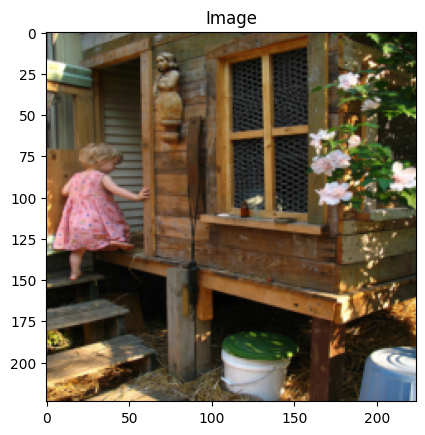

Token : tensor([  1,   4,   7, 316,  76,   4, 157,  74,   5,   2])
Sentence: 
['<SOS>', 'a', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<EOS>']


In [27]:
img, caps = dataset[1]
# print(caps)
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

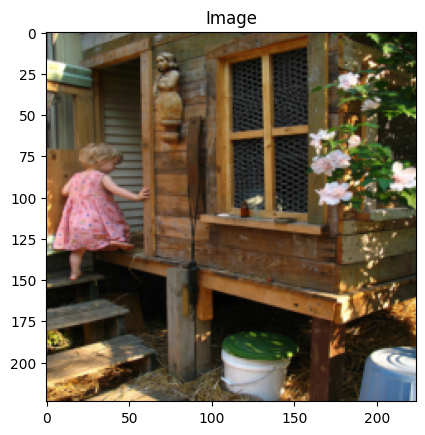

Token : tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence: 
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [28]:
img, caps = dataset[0]
show_image(img,"Image")
print("Token :",caps)
print("Sentence: ")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [29]:
class CapsCollate:
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
#         print(f"shape - {(imgs)}")
#         print("----"*22)
        imgs = torch.cat(imgs,dim=0)
#         print(f"shape - {imgs}")
#         print("------")
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

"creating the data loader to load the dataset in batches."

In [30]:
#writing the dataloader
#setting the constants
BATCH_SIZE = 4
NUM_WORKER = 2

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

data_loader = DataLoader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
)

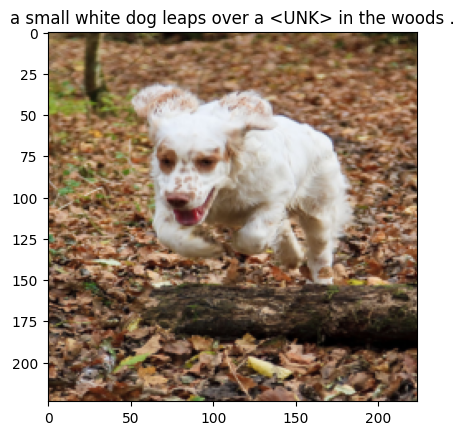

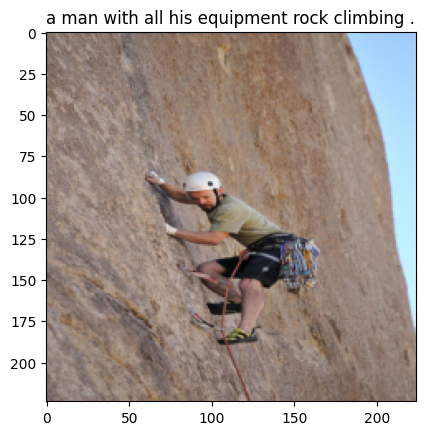

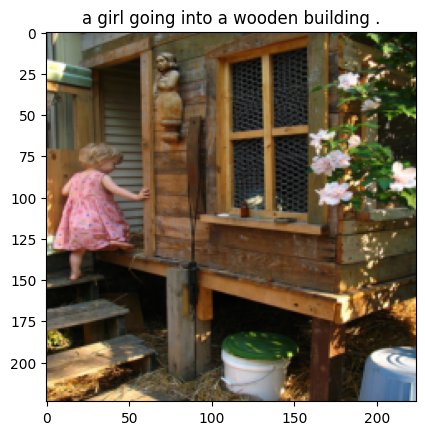

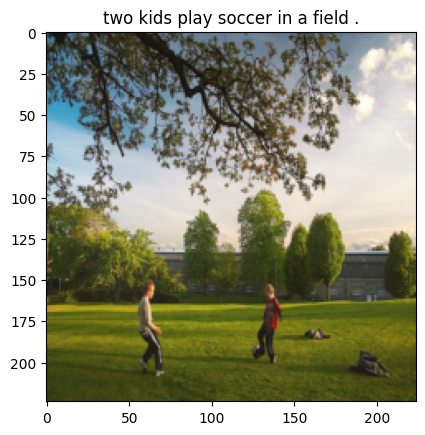

In [31]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
#     print(f"captions - {captions[i]}")
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img,caption_label)
    plt.show()

In [32]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim

In [ ]:
# vgg16 = models.resnet50(pretrained=True)
# for param in vgg16.parameters():
#     param.requires_grad_(False)
# modules = list(vgg16.children())[:-1]
# print(dir(vgg16))

# ENCODERCNN class

This class is where the feature extraction model is there. We utilized two feature extractors: **VGG16 **and **resnet50**. There are several others that can also be used. Care must be taken to ensure the output and the input given to the instance of this class as that may cause the feature extractor to either work properly or raise errors. 

Here we are using the vgg16 pretrained model.

# DECODER-RNN class

It takes the features generated by the encoder and gives an output i.e the predicted caption tensor. It also has a generated-caption function that returns the generated caption: list of words i.e. the predicted words.

In [33]:
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        super(EncoderCNN, self).__init__()
        vgg16 = models.vgg16(pretrained=True)
        for param in vgg16.parameters():
            param.requires_grad_(False)
        
        modules = list(vgg16.features.children()) + [nn.AdaptiveAvgPool2d((7, 7))]
        self.vgg16 = nn.Sequential(*modules)
        
        # Replace the last linear layer
        in_features = vgg16.classifier[-1].in_features
        classifier = list(vgg16.classifier.children())[:-1]  # Exclude the last linear layer
        classifier.append(nn.Linear(in_features, embed_size))
        self.classifier = nn.Sequential(*classifier)
        

        

    def forward(self, images):
        features = self.vgg16(images)
        features = features.view(features.size(0), -1)
        features = self.classifier(features)
        return features


class DecoderRNN(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(DecoderRNN,self).__init__()
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.gru = nn.GRU(embed_size,hidden_size,num_layers=num_layers,batch_first=True)
        self.fcn = nn.Linear(hidden_size,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    
    def forward(self,features, captions):
        # vectorize the caption
#         print(f"captions - {captions[:,:-1]}")
#         print(f"caption shape - {captions[:,:-1].shape}")
        embeds = self.embedding(captions[:,:-1])
#         print(f"shape of embeds - {embeds.shape}")
        # concat the features and captions
#         print(f"features shape - {features.shape}")
#         print(f"features unsqueeze at index 1 shape - {features.unsqueeze(1).shape}")
        x = torch.cat((features.unsqueeze(1),embeds),dim=1)
#         print(f"shape of x - {x.shape}")
        x,_ = self.gru(x)
#         print(f"shape of x after lstm - {x.shape}")
        x = self.fcn(x)
#         print(f"shape of x after fcn - {x.shape}")
        return x
    
    def generate_caption(self,inputs,hidden=None,max_len=40,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = inputs.size(0)
        
        captions = []
        
        for i in range(max_len):
            output,hidden = self.gru(inputs,hidden)
            output = self.fcn(output)
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            inputs = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions]


class EncoderDecoder(nn.Module):
    def __init__(self,embed_size,hidden_size,vocab_size,num_layers=1,drop_prob=0.3):
        super(EncoderDecoder,self).__init__()
        self.encoder = EncoderCNN(embed_size)
        self.decoder = DecoderRNN(embed_size,hidden_size,vocab_size,num_layers,drop_prob)
    
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs
# resenet features shape - torch.Size([4, 2048, 1, 1])
# resenet features viewed shape - torch.Size([4, 2048])
# resenet features embed shape - torch.Size([4, 400])
# caption shape - torch.Size([4, 14])
# shape of embeds - torch.Size([4, 14, 400])
# features shape - torch.Size([4, 400])
# features unsqueeze at index 1 shape - torch.Size([4, 1, 400])
# shape of x - torch.Size([4, 15, 400])
# shape of x after lstm - torch.Size([4, 15, 512])
# shape of x after fcn - torch.Size([4, 15, 2994])

In [34]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

# Setting the hyperparameters.

By changing and tuning these one can get a good model, maybe in few epochs. However, we have fixed them to make it easy to compare the models.

In [35]:
# Hyperparameters
embed_size = 400
hidden_size = 512
vocab_size = len(dataset.vocab)
num_layers = 2
learning_rate = 0.0001
num_epochs = 2

In [36]:
# initialize model, loss etc
model = EncoderDecoder(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 204MB/s]


# Model Training

Set the num_epochs to 20.

Technically, image caption models are trained for many more epochs, however due to resource(compute units) constraints of the Google Colab, we are limiting the model training to only this many epochs.

For 20 epochs the model took about ~3 hrs.

Epoch: 1 loss: 2.92163 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a bench with a <UNK> <UNK> . <EOS>


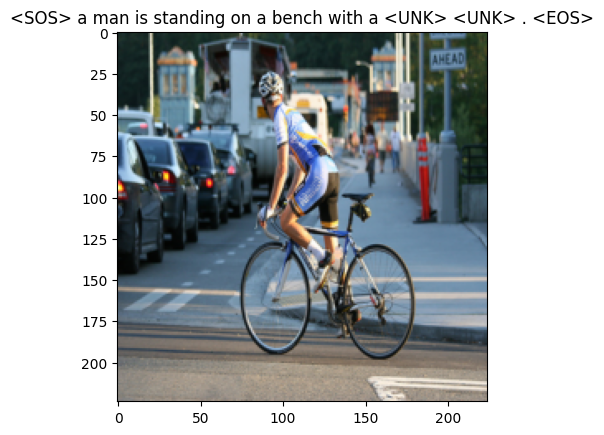

Epoch: 1 loss: 2.56038 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is riding a bike on a dirt path . <EOS>


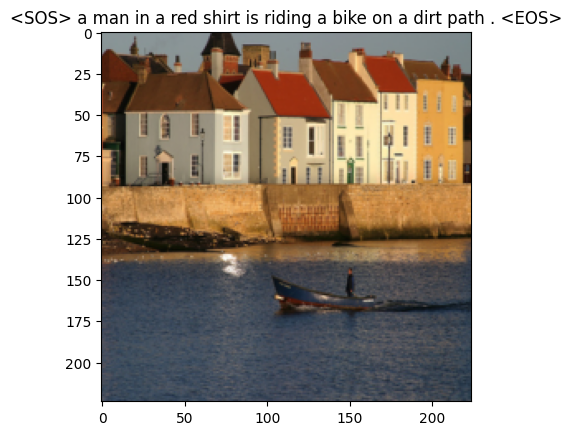

Epoch: 2 loss: 2.74276 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black dog is running through the water . <EOS>


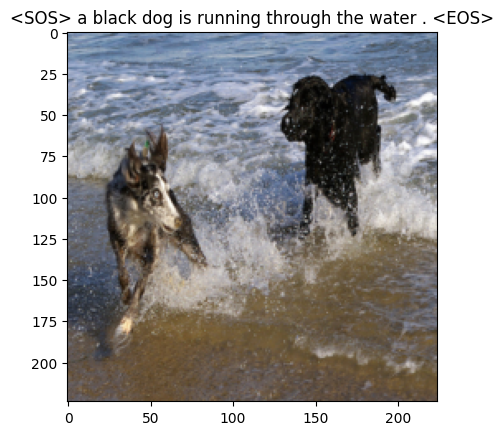

Epoch: 2 loss: 2.60599 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a blue shirt is standing on a rock . <EOS>


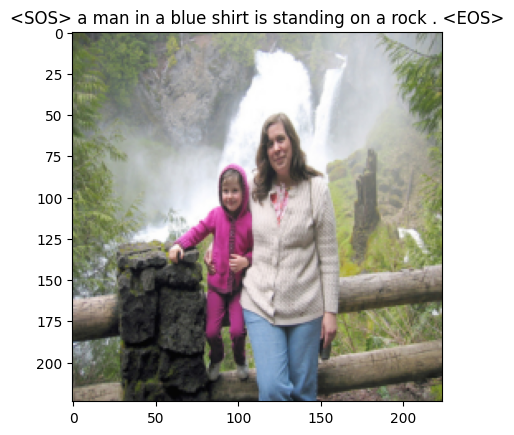

Epoch: 3 loss: 2.49977 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt and helmet is riding a bike on a dirt road . <EOS>


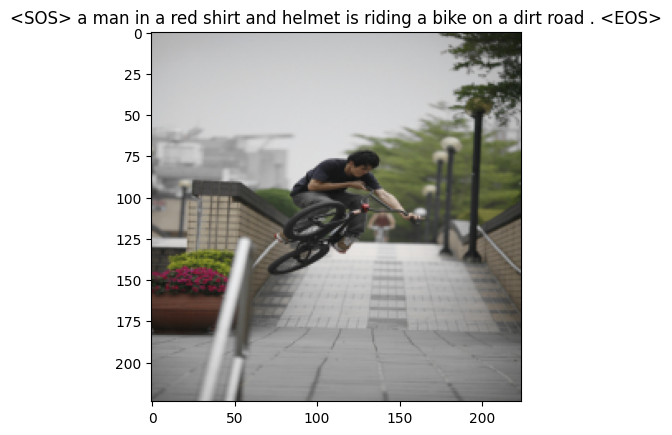

Epoch: 3 loss: 2.39336 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man and a woman are sitting on a rock . <EOS>


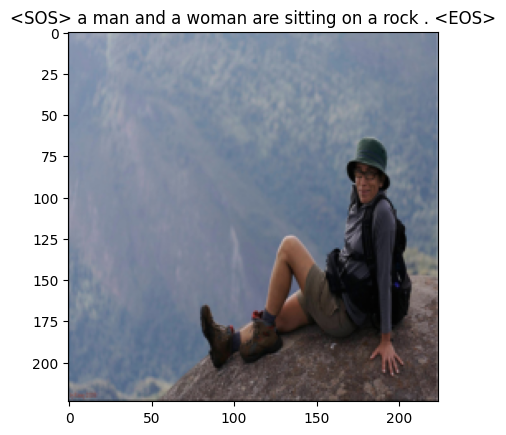

Epoch: 4 loss: 2.59678 iter:4000
features shape - torch.Size([1, 400])
<SOS> a small dog is running through a grassy area . <EOS>


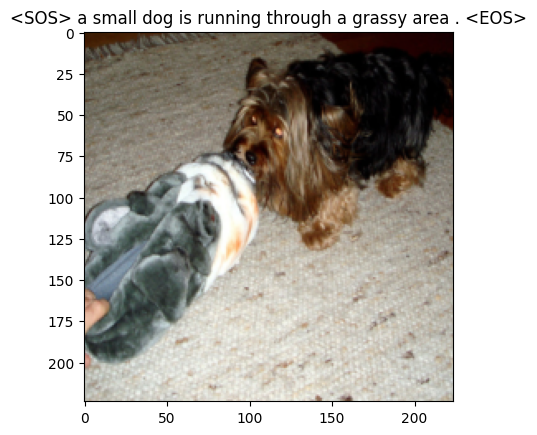

Epoch: 4 loss: 2.53227 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog is running through a field . <EOS>


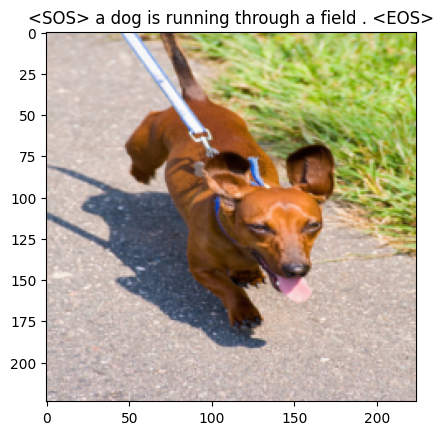

Epoch: 5 loss: 2.10746 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman wearing sunglasses . <EOS>


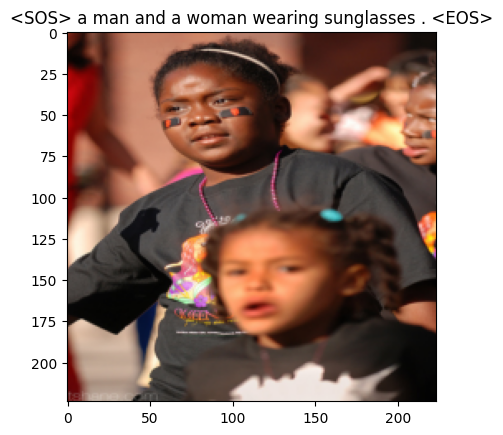

Epoch: 5 loss: 2.44001 iter:8000
features shape - torch.Size([1, 400])
<SOS> a group of people are standing in a field of <UNK> . <EOS>


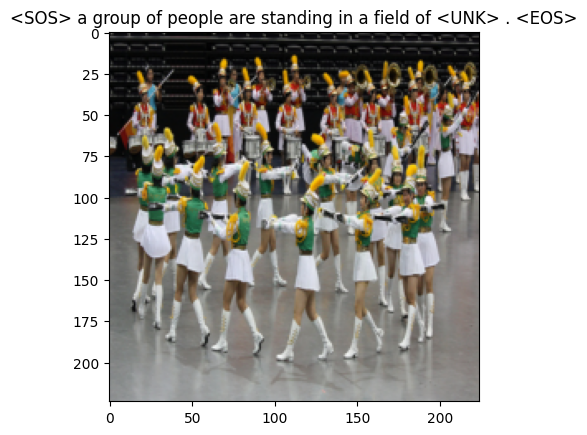

Epoch: 6 loss: 1.72913 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man is climbing a rock wall . <EOS>


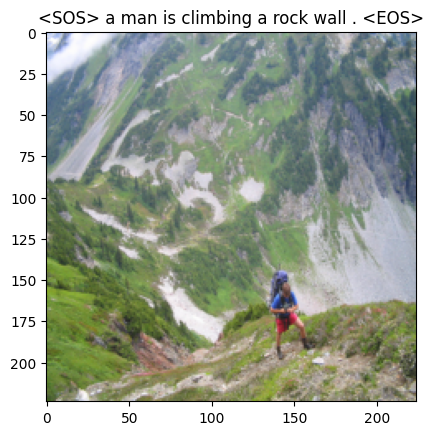

Epoch: 6 loss: 1.56613 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog runs through the water . <EOS>


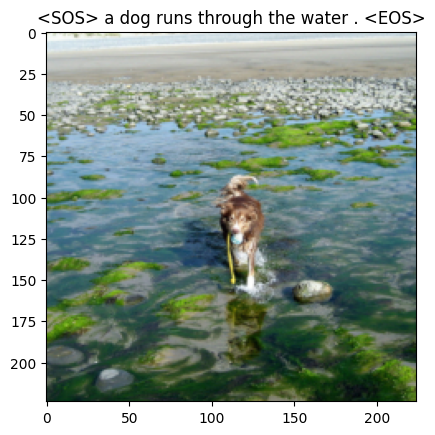

Epoch: 7 loss: 2.19913 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black dog running in grass . <EOS>


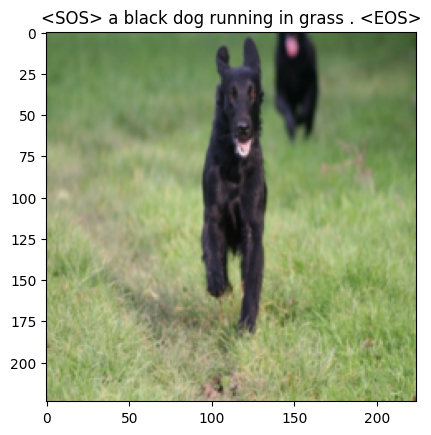

Epoch: 7 loss: 1.45570 iter:8000
features shape - torch.Size([1, 400])
<SOS> a dog swimming in the water . <EOS>


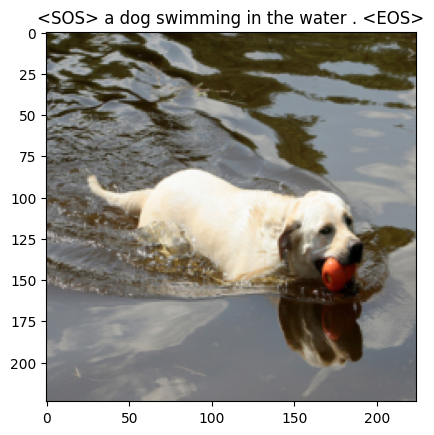

Epoch: 8 loss: 2.13344 iter:4000
features shape - torch.Size([1, 400])
<SOS> a black and white dog is running on the grass . <EOS>


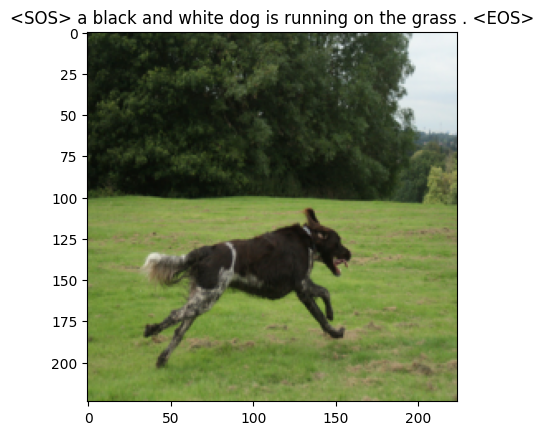

Epoch: 8 loss: 2.03177 iter:8000
features shape - torch.Size([1, 400])
<SOS> a basketball player in white is dribbling the ball . <EOS>


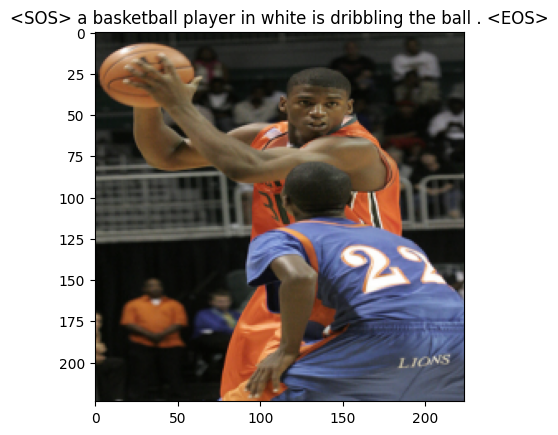

Epoch: 9 loss: 2.13288 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man and a woman sit on a bench . <EOS>


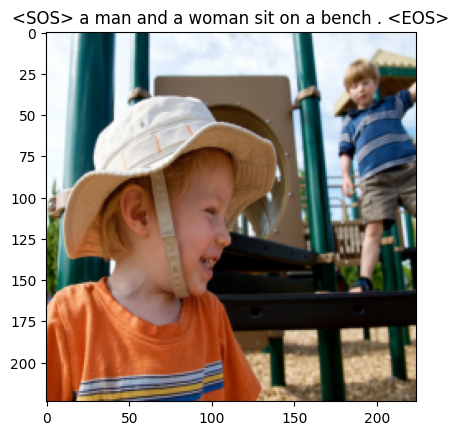

Epoch: 9 loss: 1.64940 iter:8000
features shape - torch.Size([1, 400])
<SOS> a girl is standing in the ocean with a fishing pole . <EOS>


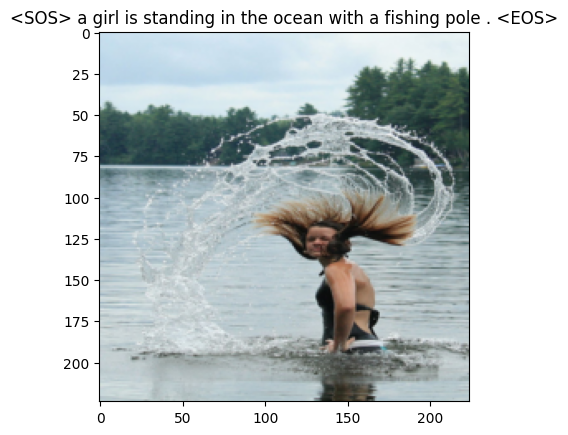

Epoch: 10 loss: 1.58008 iter:4000
features shape - torch.Size([1, 400])
<SOS> two dogs are running on the beach . <EOS>


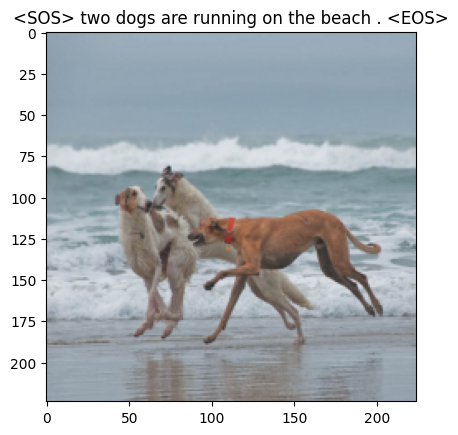

Epoch: 10 loss: 1.79354 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man is standing on a surfboard in the ocean . <EOS>


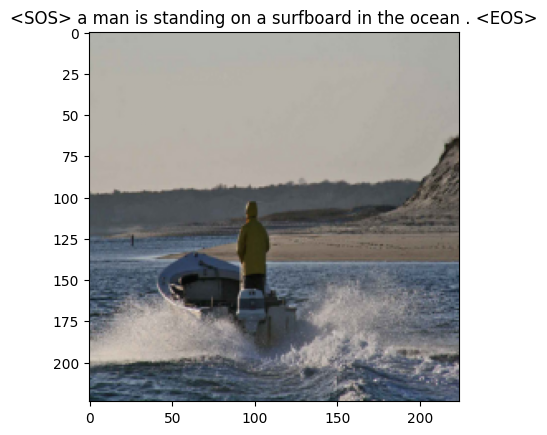

Epoch: 11 loss: 2.09245 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red jacket and black pants is skiing down a hill . <EOS>


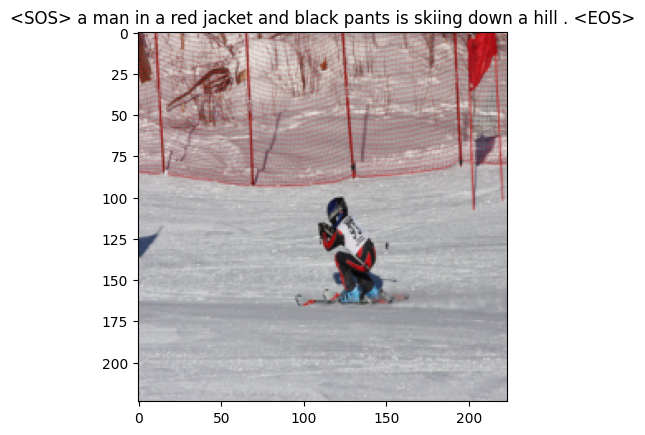

Epoch: 11 loss: 1.48414 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a black shirt is standing in a crowd holding a white object . <EOS>


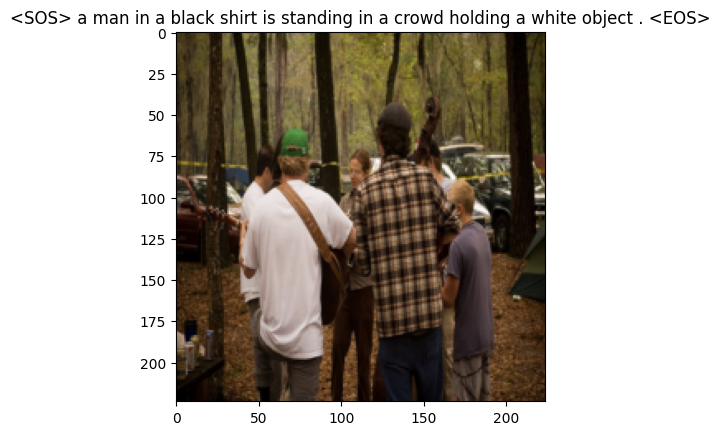

Epoch: 12 loss: 1.26244 iter:4000
features shape - torch.Size([1, 400])
<SOS> a boat with a white and blue sail boat on the water <EOS>


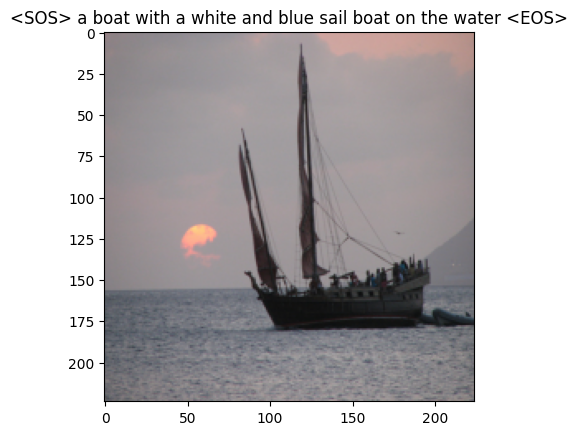

Epoch: 12 loss: 1.74752 iter:8000
features shape - torch.Size([1, 400])
<SOS> two white dogs are playing with a toy on the ground . <EOS>


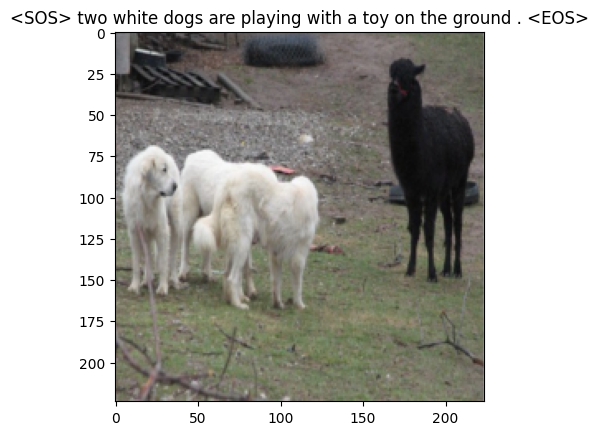

Epoch: 13 loss: 1.39986 iter:4000
features shape - torch.Size([1, 400])
<SOS> a soccer player in a red uniform is running with the ball while the opposing team tries to tackle him . <EOS>


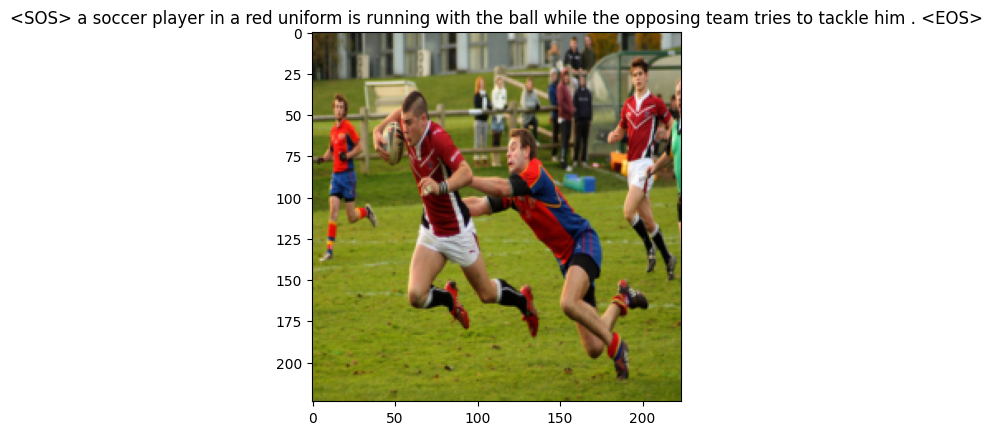

Epoch: 13 loss: 1.33577 iter:8000
features shape - torch.Size([1, 400])
<SOS> a snowboarder is in the air over a snowy hill . <EOS>


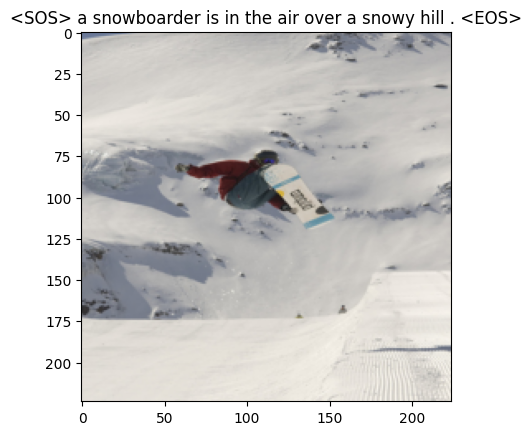

Epoch: 14 loss: 1.09403 iter:4000
features shape - torch.Size([1, 400])
<SOS> a dog is running through the water . <EOS>


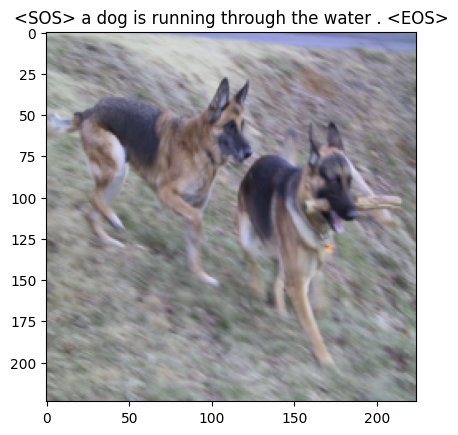

Epoch: 14 loss: 1.41531 iter:8000
features shape - torch.Size([1, 400])
<SOS> a little girl in a pink shirt is jumping off the bed into a swimming pool . <EOS>


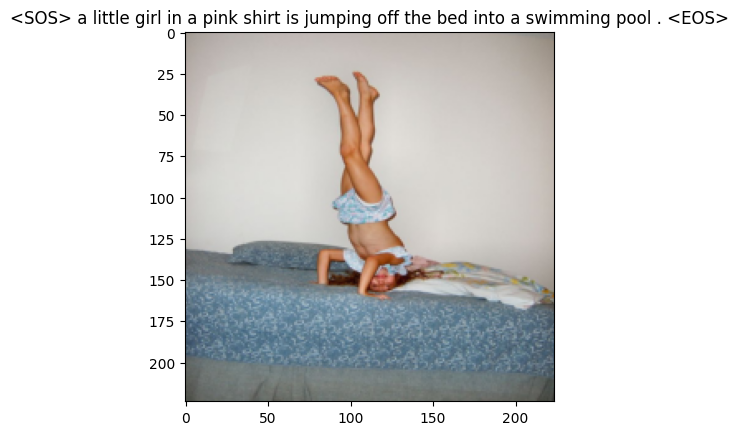

Epoch: 15 loss: 1.11155 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is running in a race . <EOS>


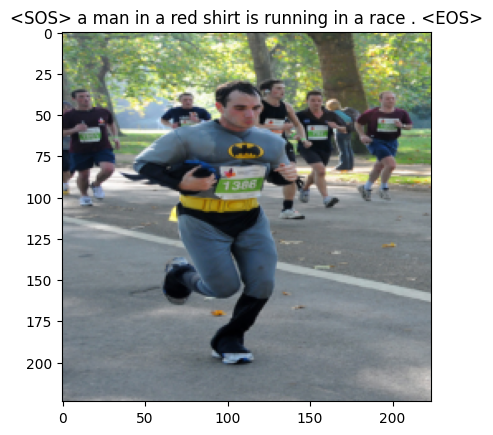

Epoch: 15 loss: 1.49508 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red shirt is standing in front of a white building . <EOS>


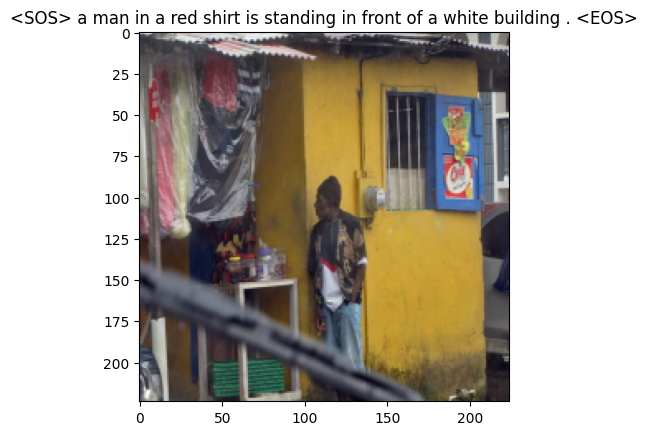

Epoch: 16 loss: 1.55177 iter:4000
features shape - torch.Size([1, 400])
<SOS> a white dog is biting a black dog . <EOS>


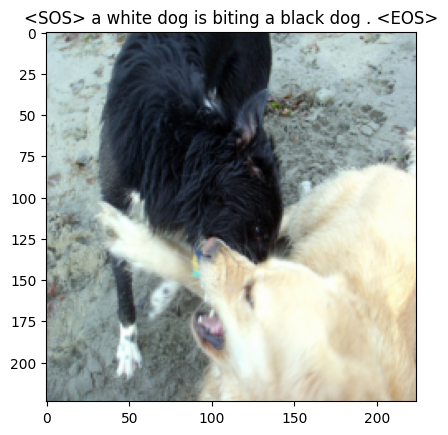

Epoch: 16 loss: 1.22114 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in sunglasses and a hat is standing in front of a green building . <EOS>


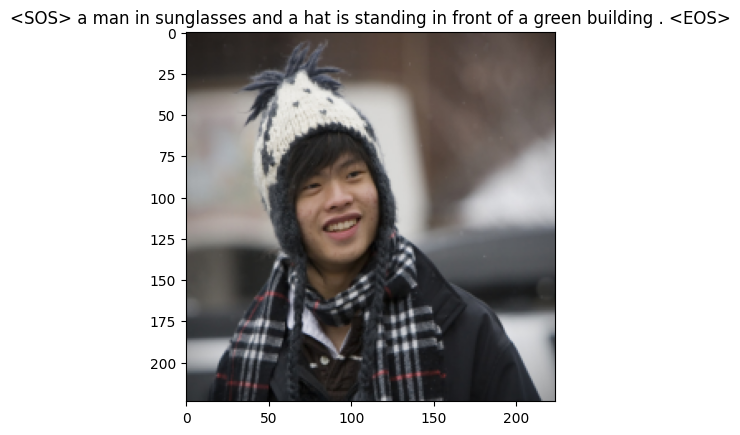

Epoch: 17 loss: 0.92477 iter:4000
features shape - torch.Size([1, 400])
<SOS> two people are walking up a sidewalk with <UNK> on the street . <EOS>


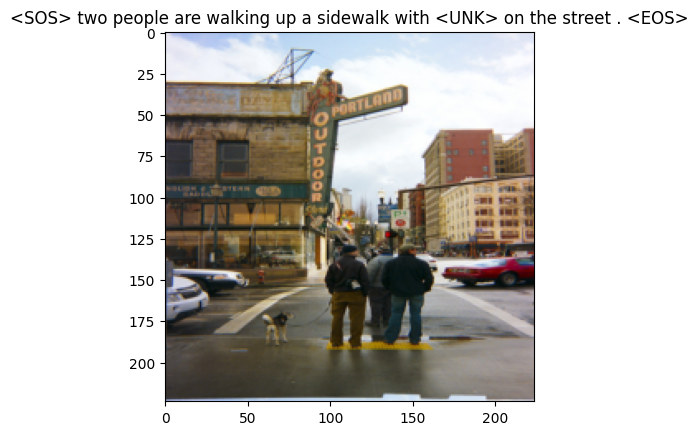

Epoch: 17 loss: 1.19290 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man is helping a girl in an orange dress dancing . <EOS>


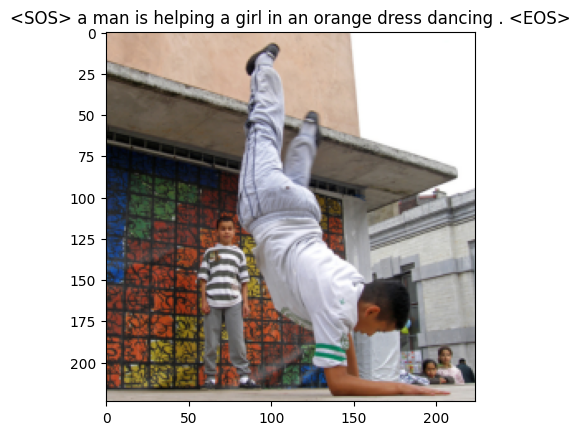

Epoch: 18 loss: 1.05328 iter:4000
features shape - torch.Size([1, 400])
<SOS> a man with a beard is sitting in the grass between two rocks . <EOS>


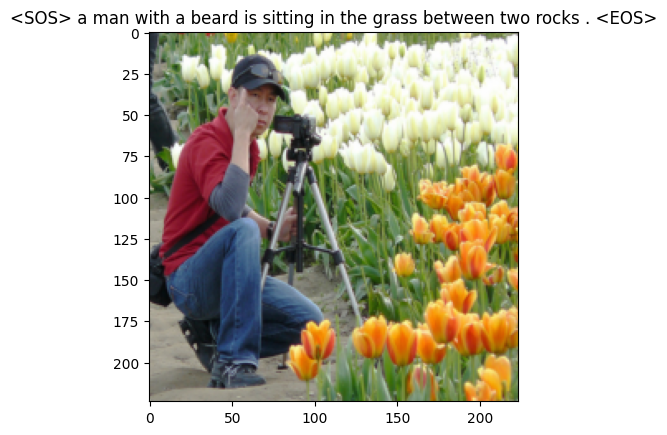

Epoch: 18 loss: 1.12469 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man sits on a bench reading a newspaper . <EOS>


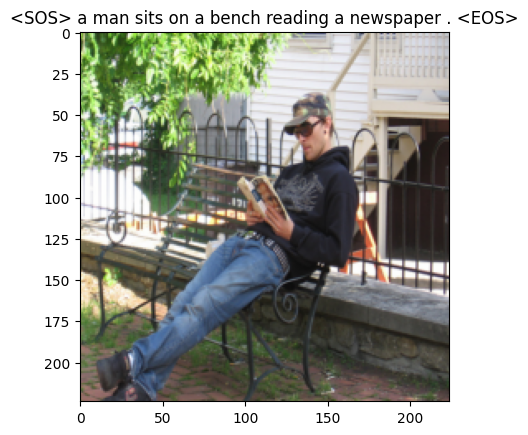

Epoch: 19 loss: 1.29461 iter:4000
features shape - torch.Size([1, 400])
<SOS> four women in <UNK> dance together . <EOS>


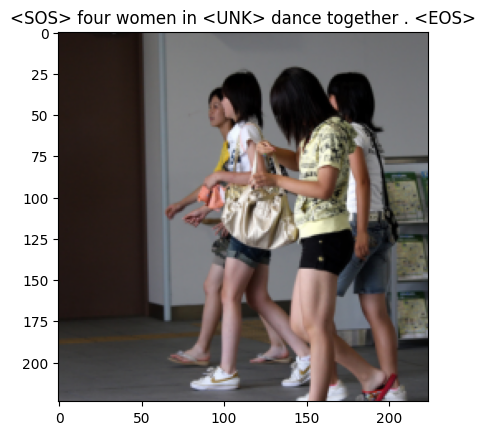

Epoch: 19 loss: 1.03625 iter:8000
features shape - torch.Size([1, 400])
<SOS> a man in a red jacket and a woman in a red dress and black <UNK> walk to the side . <EOS>


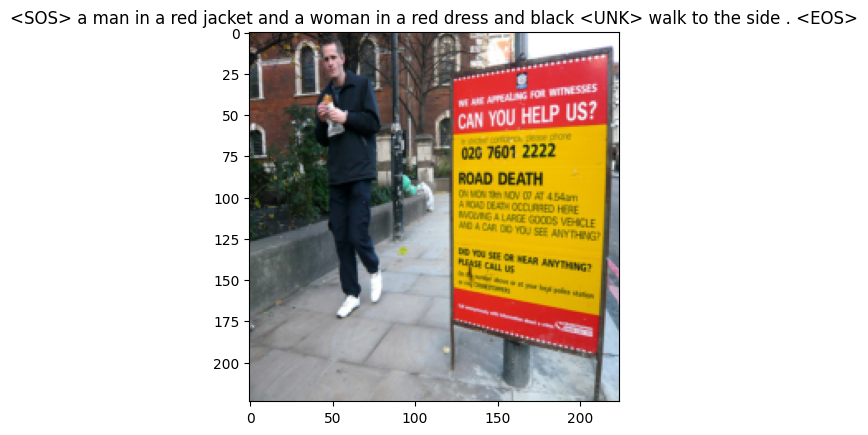

Epoch: 20 loss: 0.86180 iter:4000
features shape - torch.Size([1, 400])
<SOS> a boy smiles at the camera with a smile behind him . <EOS>


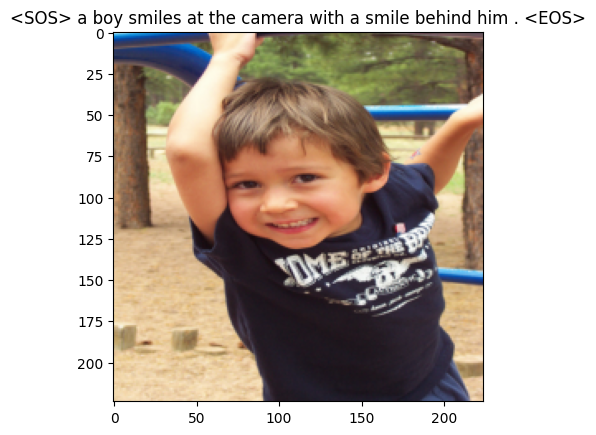

Epoch: 20 loss: 1.46071 iter:8000
features shape - torch.Size([1, 400])
<SOS> a black dog is running through the grass with a yellow toy in its mouth . <EOS>


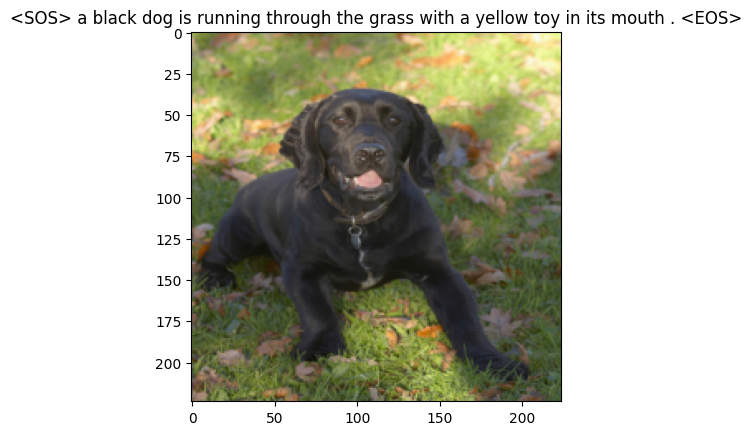

In [37]:
num_epochs = 20
print_every = 4000

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in (enumerate(iter(data_loader))):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs = model(image, captions)
        
        # Calculate the batch loss.
        loss = criterion(outputs.view(-1, vocab_size), captions.view(-1))

        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()

        writer.add_scalar("Training loss/epoch", loss.item(), global_step = epoch)
        
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f} iter:{}".format(epoch,loss.item(),idx+1))

            
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                print(f"features shape - {features.shape}")
                caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=dataset.vocab)
                caption = ' '.join(caps)
                print(caption)
                show_image(img[0],title=caption)
                
            model.train()



# Loading the Tensorboard 

In [38]:
%load_ext tensorboard
%tensorboard --logdir /content/vgg16_gru --port 8088

<IPython.core.display.Javascript object>

Using the Tensorboard for Scalars and setting the horizontal axis as steps doesn't provides a good understanding of the model. However, by changing the horizonrtal axis to relative and/or to wall assists in better understanding of the model.

### Here, I am showing loss trend for each epoch.

And by setting the horizontal axis as **step** we see the loses for all the 20 epochs as well. 

Thus, going relative and/or wall shows much better.

Another way to get the same thing but for step is to create a new variable steps that keeps on increasing by +1 at each cycle and simply, setting the `global_step = steps` before starting the training loop as follows:



```
writer.add_scalar("Training loss/epoch", loss.item(), global_step = steps)
steps+=1
```

steps is initialised before the outer epoch loop

# Testing the model

In this step we take a random image from the testing sample( size : 455), find its generated caption and then find the bleu-scores by comparing the original/human captions to the generated/predicted caption.

In [39]:
import random
import pandas as pd
def testing():
  img_no = random.randrange(0,455,5)
  test_data_df = pd.read_csv(test_data_location)
  img_name = test_data_df['image'][img_no]
  original = test_data_df[test_data_df['image'] == img_name]['caption'].tolist()
  ref = []
  for i in original:
    ref.append([token.text.lower() for token in spacy_eng.tokenizer(i)])
  
  print('image_name : \t', img_name)
  print('original_captions: \t', original)
  print('references to be passed: \t', ref)
  model.eval()
  with torch.no_grad():
    img_location = os.path.join(image_data_location,img_name)
    img = Image.open(img_location).convert("RGB")
    transformed_image = transforms(img)
    show_image(transformed_image)
    features = model.encoder(transformed_image.unsqueeze(0).to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab = dataset.vocab)
    _1,_2,_3,_4 = bleu_score(ref, caps)
    return _1, _2, _3, _4


# Finding the bleu scores

In [40]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4
def bleu_score(original_captions, generated_caption):
  generated_caption.remove('<SOS>')
  generated_caption.remove('<EOS>')
  print('BLEU Scores :')
  print('A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.')
  b_1 = sentence_bleu(original_captions, generated_caption, weights=(1.0, 0, 0, 0))
  b_2 = sentence_bleu(original_captions, generated_caption, weights=(0.5, 0.5, 0, 0))
  b_3 = sentence_bleu(original_captions, generated_caption, weights=(0.3, 0.3, 0.3, 0), smoothing_function  = smoothie)
  b_4 = sentence_bleu(original_captions, generated_caption, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function = smoothie)

  print("\ngenerated-caption : \t" , ' '.join(generated_caption))

  print('BLEU-1: %f' % b_1)
  print('BLEU-2: %f' % b_2)
  print('BLEU-3: %f' % b_3)
  print('BLEU-4: %f' % b_4)

  return b_1, b_2, b_3, b_4


# Finding the average bleu-scores of 10 random samples(images) from the testing data.


*****NEW_INPUT*******



image_name : 	 96399948_b86c61bfe6.jpg
original_captions: 	 ['A giant inflatable ball , taller than a man , is chased by two men in orange shirts .', 'The men are on a hill with a giant white ball .', 'Two men are trying to push this very large inflatable golf ball', 'two men roll a huge ball .', 'Two workers in orange and black set up bubble']
references to be passed: 	 [['a', 'giant', 'inflatable', 'ball', ',', 'taller', 'than', 'a', 'man', ',', 'is', 'chased', 'by', 'two', 'men', 'in', 'orange', 'shirts', '.'], ['the', 'men', 'are', 'on', 'a', 'hill', 'with', 'a', 'giant', 'white', 'ball', '.'], ['two', 'men', 'are', 'trying', 'to', 'push', 'this', 'very', 'large', 'inflatable', 'golf', 'ball'], ['two', 'men', 'roll', 'a', 'huge', 'ball', '.'], ['two', 'workers', 'in', 'orange', 'and', 'black', 'set', 'up', 'bubble']]


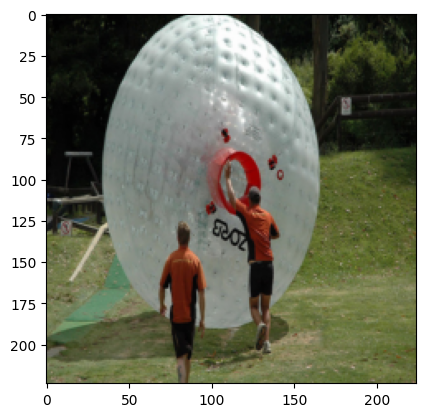

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a young girl in a pink dress in midair
BLEU-1: 0.333333
BLEU-2: 0.000000
BLEU-3: 0.070343
BLEU-4: 0.033866

*****NEW_INPUT*******



image_name : 	 890734502_a5ae67beac.jpg
original_captions: 	 ['A boy in a black swimsuit playing near the water .', 'A boy is splashing water in his bathing suit .', 'A little shirtless boy in shorts splashes water .', 'Boy in black swim trunks playing in spray of water .', 'Young boy splashes water at the edge of a pool .']
references to be passed: 	 [['a', 'boy', 'in', 'a', 'black', 'swimsuit', 'playing', 'near', 'the', 'water', '.'], ['a', 'boy', 'is', 'splashing', 'water', 'in', 'his', 'bathing', 'suit', '.'], ['a', 'little', 'shirtless', 'boy', 'in', 'shorts', 'splashes', 'water', '.'], ['boy', 'in', 'black', 'swim', 'trunks', 'playing', 'in', 'spray', 'of', 'water', '.'], ['young', 'boy', 'splashes', 'water', 'at', 't

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

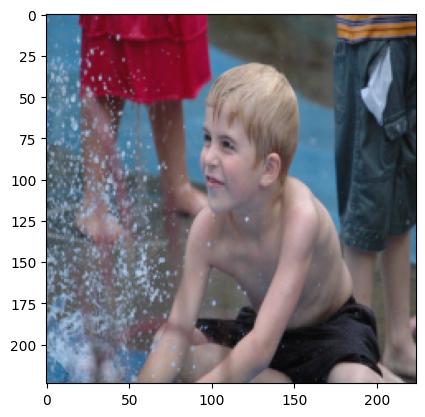

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a young girl in a swimming pool playing with a sprinkler .
BLEU-1: 0.583333
BLEU-2: 0.230283
BLEU-3: 0.136757
BLEU-4: 0.065308

*****NEW_INPUT*******



image_name : 	 96420612_feb18fc6c6.jpg
original_captions: 	 ['A man in red swim trunks is jumping onto a bodyboard .', 'A man in red trunks flies through the air with a boogie board .', 'A man with a wake-board is diving over a surface that is not water .', 'A shirtless man bodysurfs .', 'Man is diving onto his wakeboard .']
references to be passed: 	 [['a', 'man', 'in', 'red', 'swim', 'trunks', 'is', 'jumping', 'onto', 'a', 'bodyboard', '.'], ['a', 'man', 'in', 'red', 'trunks', 'flies', 'through', 'the', 'air', 'with', 'a', 'boogie', 'board', '.'], ['a', 'man', 'with', 'a', 'wake', '-', 'board', 'is', 'diving', 'over', 'a', 'surface', 'that', 'is', 'not', 'water', '.'], ['a', 'shirtless', 'man', 'bodysu

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


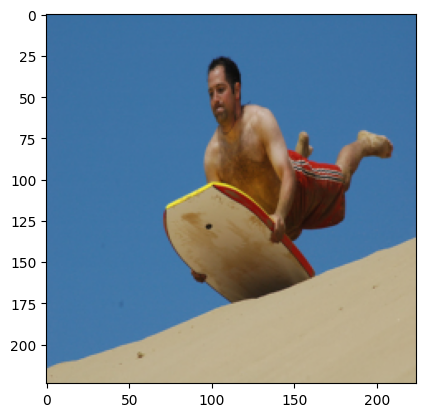

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man in a wetsuit surfing a wave .
BLEU-1: 0.666667
BLEU-2: 0.408248
BLEU-3: 0.325856
BLEU-4: 0.171838

*****NEW_INPUT*******



image_name : 	 96973080_783e375945.jpg
original_captions: 	 ['A brown dog is running over snow near leafless trees .', 'A brown dog runs across a snowy field .', 'A dog is running through the snow .', 'A dog runs through the snow .', 'A medium sized brown dog is running through an open white wooded area .']
references to be passed: 	 [['a', 'brown', 'dog', 'is', 'running', 'over', 'snow', 'near', 'leafless', 'trees', '.'], ['a', 'brown', 'dog', 'runs', 'across', 'a', 'snowy', 'field', '.'], ['a', 'dog', 'is', 'running', 'through', 'the', 'snow', '.'], ['a', 'dog', 'runs', 'through', 'the', 'snow', '.'], ['a', 'medium', 'sized', 'brown', 'dog', 'is', 'running', 'through', 'an', 'open', 'white', 'wooded', 'area', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


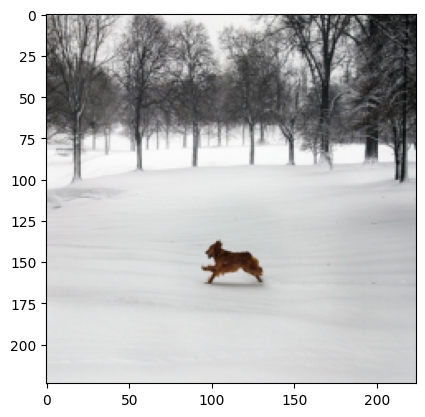

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a brown dog is running through the snow .
BLEU-1: 1.000000
BLEU-2: 1.000000
BLEU-3: 1.000000
BLEU-4: 1.000000

*****NEW_INPUT*******



image_name : 	 985067019_705fe4a4cc.jpg
original_captions: 	 ['A boy goes down an inflatable slide .', 'A boy in red slides down an inflatable ride .', 'A boy is sliding down in a red shirt .', 'A child going down an inflatable slide .', 'A young boy sliding down an inflatable , is looking off camera .']
references to be passed: 	 [['a', 'boy', 'goes', 'down', 'an', 'inflatable', 'slide', '.'], ['a', 'boy', 'in', 'red', 'slides', 'down', 'an', 'inflatable', 'ride', '.'], ['a', 'boy', 'is', 'sliding', 'down', 'in', 'a', 'red', 'shirt', '.'], ['a', 'child', 'going', 'down', 'an', 'inflatable', 'slide', '.'], ['a', 'young', 'boy', 'sliding', 'down', 'an', 'inflatable', ',', 'is', 'looking', 'off', 'camera', '.']]


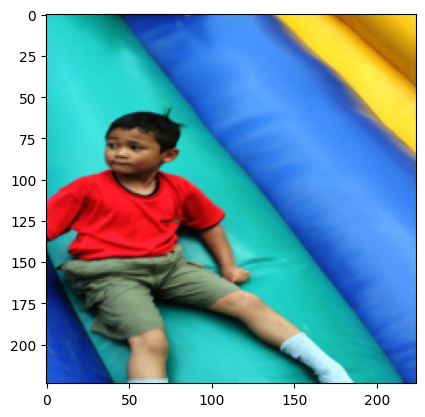

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a young boy slides down a blue slide with his eyes closed and making gesture in a <UNK> pose .
BLEU-1: 0.450000
BLEU-2: 0.307794
BLEU-3: 0.207192
BLEU-4: 0.098135

*****NEW_INPUT*******



image_name : 	 95728660_d47de66544.jpg
original_captions: 	 ['A guy is riding a bike up the side of a hill .', 'A young man bicycles towards the camera and away from beautiful mountains on a clear day .', 'Man on bike in mountains', 'Man riding a bicycle down a narrow path .', 'man riding bike on trail']
references to be passed: 	 [['a', 'guy', 'is', 'riding', 'a', 'bike', 'up', 'the', 'side', 'of', 'a', 'hill', '.'], ['a', 'young', 'man', 'bicycles', 'towards', 'the', 'camera', 'and', 'away', 'from', 'beautiful', 'mountains', 'on', 'a', 'clear', 'day', '.'], ['man', 'on', 'bike', 'in', 'mountains'], ['man', 'riding', 'a', 'bicycle', 'down', 'a', 'narrow', 'path', '.']

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


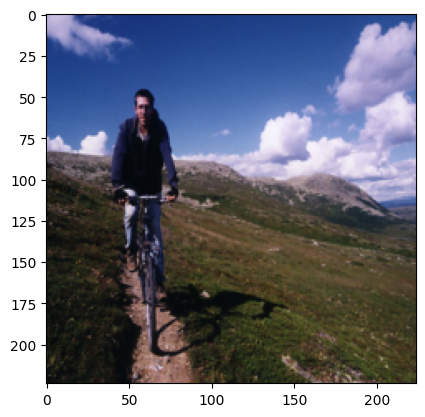

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a woman in a red jacket stands next to a mountain on the shore .
BLEU-1: 0.466667
BLEU-2: 0.000000
BLEU-3: 0.061939
BLEU-4: 0.026987

*****NEW_INPUT*******



image_name : 	 956164675_9ee084364e.jpg
original_captions: 	 ['A runner in a yellow shirt is cresting a hill .', 'A runner with one green shoe and one white shoe runs uphill .', 'A single runner is watched by onlookers in a race .', 'Man wearing green sneakers runs down highway .', 'The runner in red and yellow has just made it up the hill .']
references to be passed: 	 [['a', 'runner', 'in', 'a', 'yellow', 'shirt', 'is', 'cresting', 'a', 'hill', '.'], ['a', 'runner', 'with', 'one', 'green', 'shoe', 'and', 'one', 'white', 'shoe', 'runs', 'uphill', '.'], ['a', 'single', 'runner', 'is', 'watched', 'by', 'onlookers', 'in', 'a', 'race', '.'], ['man', 'wearing', 'green', 'sneakers', 'runs', 'down', 'hig

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

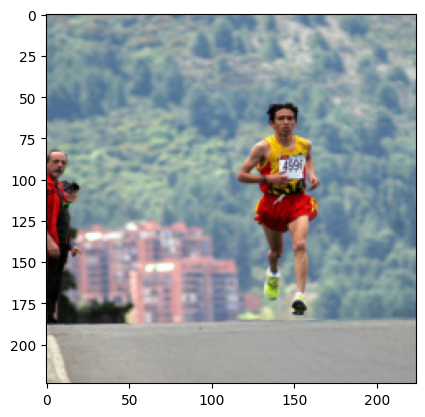

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a young boy wearing a red shirt runs along a beach .
BLEU-1: 0.666667
BLEU-2: 0.000000
BLEU-3: 0.076143
BLEU-4: 0.033712

*****NEW_INPUT*******



image_name : 	 950273886_88c324e663.jpg
original_captions: 	 ['A man grasps onto the rock face .', 'A man in a red shirt attempts to climb a rock .', 'a man wearing red , climbs a large rock .', 'man in red shirt climbing rock cliff', 'Rock climber without a rope .']
references to be passed: 	 [['a', 'man', 'grasps', 'onto', 'the', 'rock', 'face', '.'], ['a', 'man', 'in', 'a', 'red', 'shirt', 'attempts', 'to', 'climb', 'a', 'rock', '.'], ['a', 'man', 'wearing', 'red', ',', 'climbs', 'a', 'large', 'rock', '.'], ['man', 'in', 'red', 'shirt', 'climbing', 'rock', 'cliff'], ['rock', 'climber', 'without', 'a', 'rope', '.']]


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

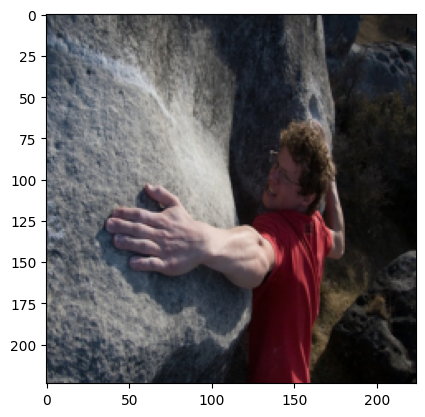

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man in a blue shirt climbs a rock while people in the background watch him .
BLEU-1: 0.588235
BLEU-2: 0.428746
BLEU-3: 0.328702
BLEU-4: 0.204552

*****NEW_INPUT*******



image_name : 	 93922153_8d831f7f01.jpg
original_captions: 	 ['A woman climbs up a cliff', 'A woman rock climber scales a cliff far above pastures .', 'A woman rock-climbing on a cliff .', 'A woman rock-climbs in a rural area .', 'Woman climbing a cliff in a rural area']
references to be passed: 	 [['a', 'woman', 'climbs', 'up', 'a', 'cliff'], ['a', 'woman', 'rock', 'climber', 'scales', 'a', 'cliff', 'far', 'above', 'pastures', '.'], ['a', 'woman', 'rock', '-', 'climbing', 'on', 'a', 'cliff', '.'], ['a', 'woman', 'rock', '-', 'climbs', 'in', 'a', 'rural', 'area', '.'], ['woman', 'climbing', 'a', 'cliff', 'in', 'a', 'rural', 'area']]


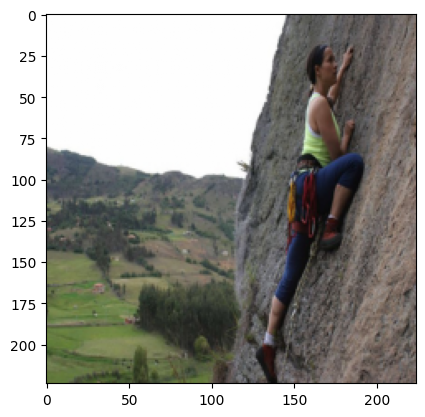

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a man in a blue jacket riding a mountain .
BLEU-1: 0.400000
BLEU-2: 0.210819
BLEU-3: 0.135545
BLEU-4: 0.067726

*****NEW_INPUT*******



image_name : 	 888517718_3d5b4b7b43.jpg
original_captions: 	 ['A brown and black dog is standing on its hind legs trying to catch something .', 'A dog is jumping up on hind legs with its mouth open .', 'A dog plays on the grass .', 'A German shepherd playing with water in the grass .', 'German Shepherd standing up snapping at droplets of water']
references to be passed: 	 [['a', 'brown', 'and', 'black', 'dog', 'is', 'standing', 'on', 'its', 'hind', 'legs', 'trying', 'to', 'catch', 'something', '.'], ['a', 'dog', 'is', 'jumping', 'up', 'on', 'hind', 'legs', 'with', 'its', 'mouth', 'open', '.'], ['a', 'dog', 'plays', 'on', 'the', 'grass', '.'], ['a', 'german', 'shepherd', 'playing', 'with', 'water', 'in', 'the', 'grass', 

/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)


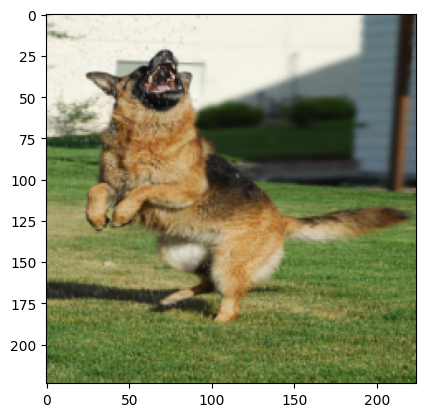

BLEU Scores :
A perfect match results in a score of 1.0, whereas a perfect mismatch results in a score of 0.0.

generated-caption : 	 a dog is jumping on the grass .
BLEU-1: 1.000000
BLEU-2: 0.925820
BLEU-3: 0.845451
BLEU-4: 0.691442

****FINDING AVERAGE SCORES****

Average_BLEU-1_score_for_the_above_printed_images: 0.615490
Average_BLEU-2_score_for_the_above_printed_images: 0.351171
Average_BLEU-3_score_for_the_above_printed_images: 0.318793
Average_BLEU-4_score_for_the_above_printed_images: 0.239357


In [47]:
b_1 = []
b_2 = []
b_3 = []
b_4 = []
for i in range(10):
  print('\n*****NEW_INPUT*******\n')
  print('\n')
  _1, _2, _3, _4 = testing()
  b_1.append(_1)
  b_2.append(_2)
  b_3.append(_3)
  b_4.append(_4)

print('\n****FINDING AVERAGE SCORES****\n')
from statistics import mean
print('Average_BLEU-1_score_for_the_above_printed_images: %f' % mean(b_1))
print('Average_BLEU-2_score_for_the_above_printed_images: %f' % mean(b_2))
print('Average_BLEU-3_score_for_the_above_printed_images: %f' % mean(b_3))
print('Average_BLEU-4_score_for_the_above_printed_images: %f' % mean(b_4))

**FROM THE ABOVE WE CAN CLEARLY UNDERSTAND ON THING :**

***THE MODEL IS PRIORITISING SINGLE WORDS OVER A COMPLETED AND BETTER SENTENCE***

THIS IS DUE TO **`argmax`** function used while generating captions.

*As can be seen from above the average values of bleu_scores. These values indicate that 1-gram bleu-score is better while 4-gram bleu score is not good. This attributes to the above stated fact that the model is preferring individual words over the complete sentences. This could potentially be solved somewhat by using beam-search based prediction method and utilizing attention layers.*

However, the key point to notice here is that the average is calculated by randomly choosing only 10 images. These Average scores can potentially increase/dexrease by taking a bigger sample or just by rerunning the testing the above loop.

However, an easier way to do is to increase the number of training epochs. One can try to train their own individual model by taking these as a starting point to further train models for more epochs and/or try beam-search based prediction techniques.  
 